# Surprise Housing Assignment

## **Problem Statement**

Surprise Housing company want to buy & sell properties in Austrialia market. They have purchased historical sales data of 
Austrilian properties. They want to know -

1.Which variables are significant in predicting the price of a house.

2.How well those variables describe the price of a house.

Note: We also need to determine the optimal value of lambda for ridge and lasso regression.

## **Solution**

In [1]:
#import required python libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
#reading required data set and checking top 5 rows
df = pd.read_csv('.\\train.csv')
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [3]:
#Check the shape of the dataframe
df.shape

(1460, 81)

In [4]:
#checking dataframe info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

### Data Handling and Cleaning

In [5]:
#checking n/a values
for col in df.columns:
    na_perc = df[col].isna().sum()/(len(df))*100
    if na_perc > 0.0:
        print(f'column name : {col}')
        print(round(na_perc))

column name : LotFrontage
18
column name : Alley
94
column name : MasVnrType
1
column name : MasVnrArea
1
column name : BsmtQual
3
column name : BsmtCond
3
column name : BsmtExposure
3
column name : BsmtFinType1
3
column name : BsmtFinType2
3
column name : Electrical
0
column name : FireplaceQu
47
column name : GarageType
6
column name : GarageYrBlt
6
column name : GarageFinish
6
column name : GarageQual
6
column name : GarageCond
6
column name : PoolQC
100
column name : Fence
81
column name : MiscFeature
96


In [6]:
#droping columns where n/a % is greator than 40%
drop_cols = ['Alley','FireplaceQu','PoolQC','Fence','MiscFeature']
df = df.drop(drop_cols, axis=1)
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,...,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,...,0,0,0,0,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,...,0,0,0,0,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,...,0,0,0,0,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,...,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,...,0,0,0,0,0,12,2008,WD,Normal,250000


In [7]:
#valdating remaining n/a
for col in df.columns:
    na_perc = df[col].isna().sum()/(len(df))*100
    if na_perc > 0.0:
        print(f'column name : {col}')
        print(f'n/a % : {round(na_perc)}')
        print(df[col].value_counts())

column name : LotFrontage
n/a % : 18
60.0     143
70.0      70
80.0      69
50.0      57
75.0      53
        ... 
137.0      1
141.0      1
38.0       1
140.0      1
46.0       1
Name: LotFrontage, Length: 110, dtype: int64
column name : MasVnrType
n/a % : 1
None       864
BrkFace    445
Stone      128
BrkCmn      15
Name: MasVnrType, dtype: int64
column name : MasVnrArea
n/a % : 1
0.0      861
180.0      8
72.0       8
108.0      8
120.0      7
        ... 
562.0      1
89.0       1
921.0      1
762.0      1
119.0      1
Name: MasVnrArea, Length: 327, dtype: int64
column name : BsmtQual
n/a % : 3
TA    649
Gd    618
Ex    121
Fa     35
Name: BsmtQual, dtype: int64
column name : BsmtCond
n/a % : 3
TA    1311
Gd      65
Fa      45
Po       2
Name: BsmtCond, dtype: int64
column name : BsmtExposure
n/a % : 3
No    953
Av    221
Gd    134
Mn    114
Name: BsmtExposure, dtype: int64
column name : BsmtFinType1
n/a % : 3
Unf    430
GLQ    418
ALQ    220
BLQ    148
Rec    133
LwQ     74
Name: 

In [8]:
#handling few n/a cases by updating with most common values
rev_values_1 = [{'LotFrontage':60.0}, {'MasVnrType':'None'}, {'MasVnrArea':0.0},  {'Electrical':'SBrkr'}]
rev_values_2 = [{'BsmtQual':'TA'}, {'BsmtCond':'TA'}, {'BsmtExposure':'No'}, {'BsmtFinType1':'Unf'}, {'BsmtFinType2':'Unf'},]
rev_values_3 = [{'GarageType':'Attchd'}, {'GarageYrBlt':'2005'}, {'GarageFinish':'Unf'}, {'GarageQual':'TA'}, {'GarageCond':'TA'}]
rev_values = rev_values_1 + rev_values_2 + rev_values_3
print(rev_values)

[{'LotFrontage': 60.0}, {'MasVnrType': 'None'}, {'MasVnrArea': 0.0}, {'Electrical': 'SBrkr'}, {'BsmtQual': 'TA'}, {'BsmtCond': 'TA'}, {'BsmtExposure': 'No'}, {'BsmtFinType1': 'Unf'}, {'BsmtFinType2': 'Unf'}, {'GarageType': 'Attchd'}, {'GarageYrBlt': '2005'}, {'GarageFinish': 'Unf'}, {'GarageQual': 'TA'}, {'GarageCond': 'TA'}]


In [9]:
#applying common values for n/a cases
for rev_value in rev_values:
    for key,value in rev_value.items():
        df[key].fillna(value, inplace=True)
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,...,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,...,0,0,0,0,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,...,0,0,0,0,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,...,0,0,0,0,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,...,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,...,0,0,0,0,0,12,2008,WD,Normal,250000


In [10]:
#re-validating n/a case
df.isna().sum()/(len(df))*100

Id               0.0
MSSubClass       0.0
MSZoning         0.0
LotFrontage      0.0
LotArea          0.0
                ... 
MoSold           0.0
YrSold           0.0
SaleType         0.0
SaleCondition    0.0
SalePrice        0.0
Length: 76, dtype: float64

In [11]:
#correcting data type of date field
df['GarageYrBlt'] = df['GarageYrBlt'].apply(lambda x: int(x))
df['GarageYrBlt'].value_counts()

2005    146
2006     59
2004     53
2003     50
2007     49
       ... 
1927      1
1900      1
1906      1
1908      1
1933      1
Name: GarageYrBlt, Length: 97, dtype: int64

In [12]:
#reviewing each column data
for col in df.columns:
    print(f'column name : {col}')
    print(df[col].value_counts())

column name : Id
1       1
982     1
980     1
979     1
978     1
       ..
485     1
484     1
483     1
482     1
1460    1
Name: Id, Length: 1460, dtype: int64
column name : MSSubClass
20     536
60     299
50     144
120     87
30      69
160     63
70      60
80      58
90      52
190     30
85      20
75      16
45      12
180     10
40       4
Name: MSSubClass, dtype: int64
column name : MSZoning
RL         1151
RM          218
FV           65
RH           16
C (all)      10
Name: MSZoning, dtype: int64
column name : LotFrontage
60.0     402
70.0      70
80.0      69
50.0      57
75.0      53
        ... 
137.0      1
141.0      1
38.0       1
140.0      1
46.0       1
Name: LotFrontage, Length: 110, dtype: int64
column name : LotArea
7200     25
9600     24
6000     17
9000     14
8400     14
         ..
14601     1
13682     1
4058      1
17104     1
9717      1
Name: LotArea, Length: 1073, dtype: int64
column name : Street
Pave    1454
Grvl       6
Name: Street, dtype: int64

In [13]:
#classifying columns in non required, continous, category & date series columns list
non_cols = ['Id']
print(f'non_cols : {non_cols}')
cont_cols_1 = ['LotFrontage', 'LotArea', 'MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF', '1stFlrSF']
cont_cols_2 = ['2ndFlrSF', 'LowQualFinSF', 'GrLivArea','3SsnPorch','ScreenPorch', 'GarageArea']
cont_cols_3 = ['WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch','PoolArea','MiscVal','SalePrice']
cont_cols = cont_cols_1 + cont_cols_2 + cont_cols_3
print(f'cont_cols : {cont_cols}')
cat_cols_1 = ['MSSubClass', 'MSZoning', 'Street', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood']
cat_cols_2 = ['Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond', 'RoofStyle', 'RoofMatl']
cat_cols_3 = ['Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond']
cat_cols_4 = ['BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical']
cat_cols_5 = ['BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual']
cat_cols_6 = ['TotRmsAbvGrd', 'Functional', 'Fireplaces', 'GarageType', 'GarageFinish', 'GarageCars', 'GarageQual']
cat_cols_7 = ['GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition', 'LotShape']
cat_cols = cat_cols_1 + cat_cols_2 + cat_cols_3 + cat_cols_4 + cat_cols_5 + cat_cols_6 + cat_cols_7
print(f'cat_cols : {cat_cols}')
dat_cols = ['YearBuilt', 'YearRemodAdd','GarageYrBlt','MoSold','YrSold']
print(f'dat_cols : {dat_cols}')

non_cols : ['Id']
cont_cols : ['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', '3SsnPorch', 'ScreenPorch', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', 'PoolArea', 'MiscVal', 'SalePrice']
cat_cols : ['MSSubClass', 'MSZoning', 'Street', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'GarageType', 'GarageFinish', 'GarageCars', 'GarageQual', 'GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition',

In [14]:
print(len(non_cols) + len(cont_cols) + len(cat_cols) + len(dat_cols))

76


In [15]:
#dropping Id column
df = df.drop(non_cols, axis=1)
df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,...,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,0,0,0,0,0,2,2008,WD,Normal,208500
1,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,...,0,0,0,0,0,5,2007,WD,Normal,181500
2,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,...,0,0,0,0,0,9,2008,WD,Normal,223500
3,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,...,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,...,0,0,0,0,0,12,2008,WD,Normal,250000


In [16]:
#mapping MSSubClass column with suitable category 
df['MSSubClass'] = df['MSSubClass'].apply(lambda x: f'MSSC{x}')
df['MSSubClass'].value_counts()

MSSC20     536
MSSC60     299
MSSC50     144
MSSC120     87
MSSC30      69
MSSC160     63
MSSC70      60
MSSC80      58
MSSC90      52
MSSC190     30
MSSC85      20
MSSC75      16
MSSC45      12
MSSC180     10
MSSC40       4
Name: MSSubClass, dtype: int64

In [17]:
#mapping OverallQual column with suitable category 
df['OverallQual'] = df['OverallQual'].apply(lambda x: f'OQ{x}')
df['OverallQual'].value_counts()

OQ5     397
OQ6     374
OQ7     319
OQ8     168
OQ4     116
OQ9      43
OQ3      20
OQ10     18
OQ2       3
OQ1       2
Name: OverallQual, dtype: int64

In [18]:
#mapping OverallCond column with suitable category 
df['OverallCond'] = df['OverallCond'].apply(lambda x: f'OC{x}')
df['OverallCond'].value_counts()

OC5    821
OC6    252
OC7    205
OC8     72
OC4     57
OC3     25
OC9     22
OC2      5
OC1      1
Name: OverallCond, dtype: int64

In [19]:
#mapping YearBuilt column with suitable category 
df['YearBuilt'] = df['YearBuilt'].apply(lambda x: f'YB{x}')
df['YearBuilt'].value_counts()

YB2006    67
YB2005    64
YB2004    54
YB2007    49
YB2003    45
          ..
YB1875     1
YB1911     1
YB1917     1
YB1872     1
YB1905     1
Name: YearBuilt, Length: 112, dtype: int64

In [20]:
#mapping YearRemodAdd column with suitable category 
df['YearRemodAdd'] = df['YearRemodAdd'].apply(lambda x: f'YRA{x}')
df['YearRemodAdd'].value_counts()

YRA1950    178
YRA2006     97
YRA2007     76
YRA2005     73
YRA2004     62
          ... 
YRA2010      6
YRA1986      5
YRA1952      5
YRA1983      5
YRA1951      4
Name: YearRemodAdd, Length: 61, dtype: int64

In [21]:
#mapping GarageYrBlt column with suitable category 
df['GarageYrBlt'] = df['GarageYrBlt'].apply(lambda x: f'GYB{x}')
df['GarageYrBlt'].value_counts()

GYB2005    146
GYB2006     59
GYB2004     53
GYB2003     50
GYB2007     49
          ... 
GYB1927      1
GYB1900      1
GYB1906      1
GYB1908      1
GYB1933      1
Name: GarageYrBlt, Length: 97, dtype: int64

In [22]:
#mapping MoSold column with suitable category 
months = { 1:'Jan', 2:'Feb', 3:'Mar',4:'Apr',5:'May',6:'Jun',7:'Jul',8:'Aug',9:'Sep',10:'Oct',11:'Nov',12:'Dec'}
df['MoSold'] = df['MoSold'].apply(lambda x: months[x])
df['MoSold'].value_counts()

Jun    253
Jul    234
May    204
Apr    141
Aug    122
Mar    106
Oct     89
Nov     79
Sep     63
Dec     59
Jan     58
Feb     52
Name: MoSold, dtype: int64

In [23]:
#mapping YrSold column with suitable category 
df['YrSold'] = df['YrSold'].apply(lambda x: f'YS{x}')
df['YrSold'].value_counts()

YS2009    338
YS2007    329
YS2006    314
YS2008    304
YS2010    175
Name: YrSold, dtype: int64

### Handling outliers

In [24]:
#calculating inter quantile range
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

LotFrontage         19.00
LotArea           4048.00
MasVnrArea         164.25
BsmtFinSF1         712.25
BsmtFinSF2           0.00
BsmtUnfSF          585.00
TotalBsmtSF        502.50
1stFlrSF           509.25
2ndFlrSF           728.00
LowQualFinSF         0.00
GrLivArea          647.25
BsmtFullBath         1.00
BsmtHalfBath         0.00
FullBath             1.00
HalfBath             1.00
BedroomAbvGr         1.00
KitchenAbvGr         0.00
TotRmsAbvGrd         2.00
Fireplaces           1.00
GarageCars           1.00
GarageArea         241.50
WoodDeckSF         168.00
OpenPorchSF         68.00
EnclosedPorch        0.00
3SsnPorch            0.00
ScreenPorch          0.00
PoolArea             0.00
MiscVal              0.00
SalePrice        84025.00
dtype: float64


In [25]:
#removing complete outlier columns
out_zero_cols = ['BsmtFinSF2', 'LowQualFinSF', 'BsmtHalfBath', 'KitchenAbvGr', 'BsmtHalfBath', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal']
df = df.drop(out_zero_cols, axis=1)
df.shape

(1460, 66)

In [26]:
#revising columns list
cont_cols_lst = cont_cols 
revised_cols = filter(lambda x: x not in out_zero_cols, cont_cols_lst)
cont_cols_lst = list(revised_cols)

cat_cols_lst = cat_cols + dat_cols
revised_cols = filter(lambda x: x not in out_zero_cols, cat_cols_lst)
cat_cols_lst = list(revised_cols)

In [27]:
#re-calculating inter quantile range
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

LotFrontage        19.00
LotArea          4048.00
MasVnrArea        164.25
BsmtFinSF1        712.25
BsmtUnfSF         585.00
TotalBsmtSF       502.50
1stFlrSF          509.25
2ndFlrSF          728.00
GrLivArea         647.25
BsmtFullBath        1.00
FullBath            1.00
HalfBath            1.00
BedroomAbvGr        1.00
TotRmsAbvGrd        2.00
Fireplaces          1.00
GarageCars          1.00
GarageArea        241.50
WoodDeckSF        168.00
OpenPorchSF        68.00
SalePrice       84025.00
dtype: float64


In [28]:
#removing outliers
df = df[~((df < (Q1 - 1.5 * IQR)) |(df > (Q3 + 1.5 * IQR))).any(axis=1)]
df.shape

(1036, 66)

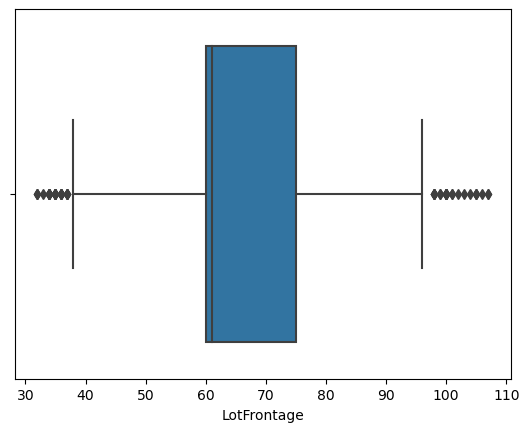

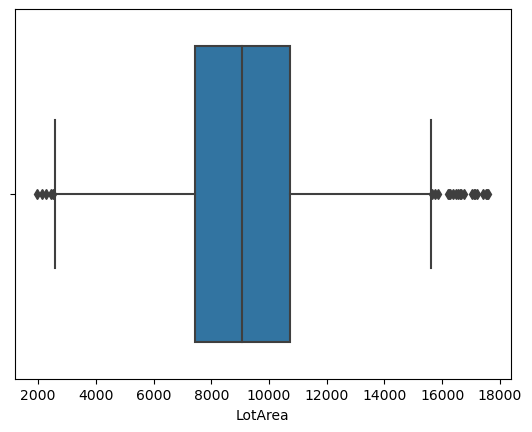

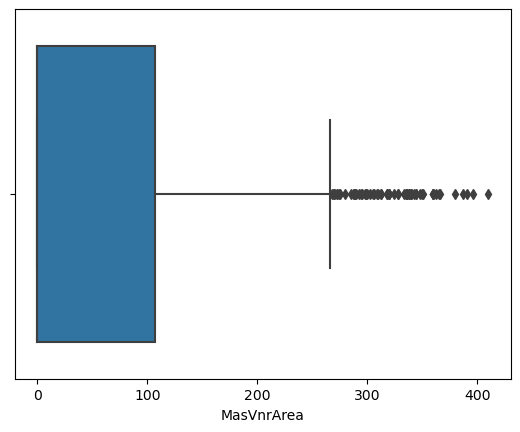

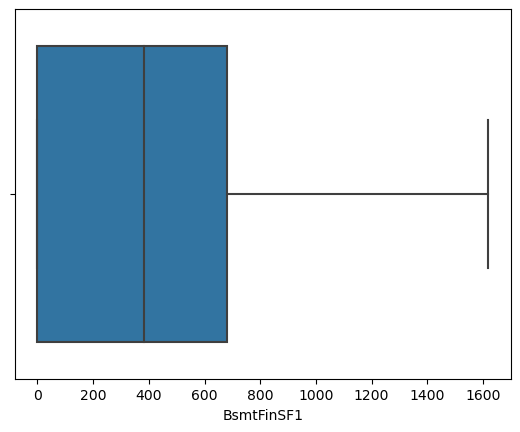

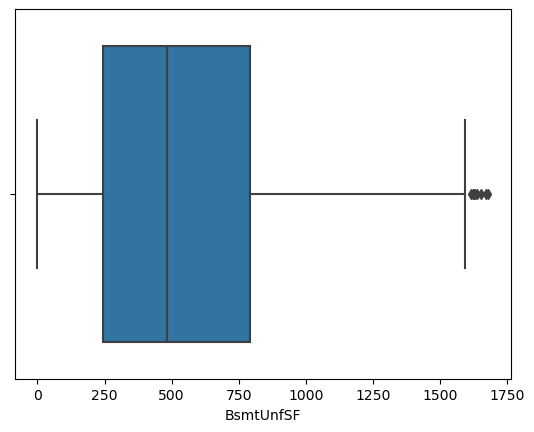

...

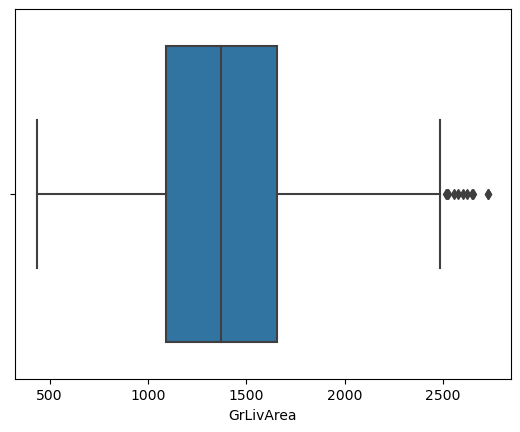

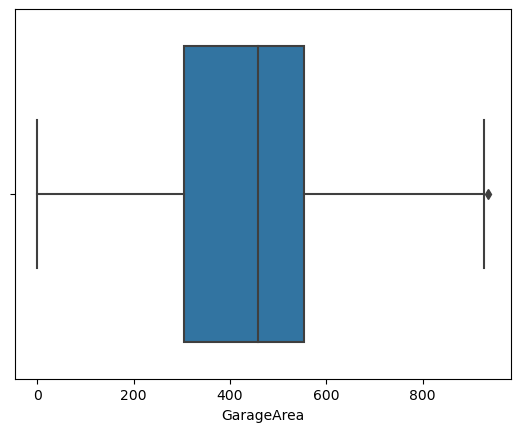

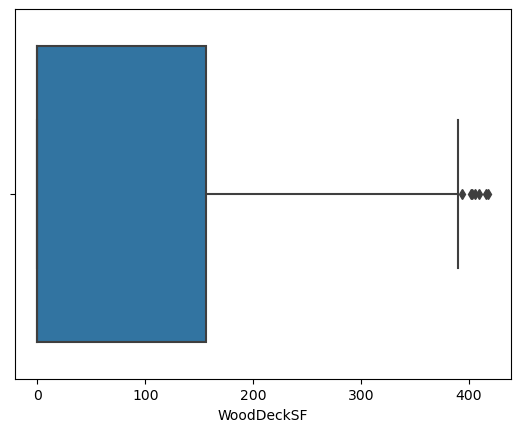

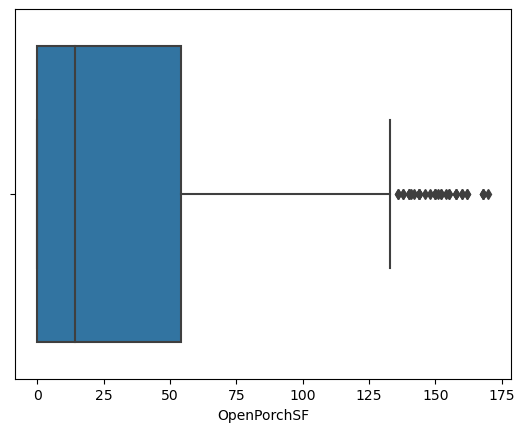

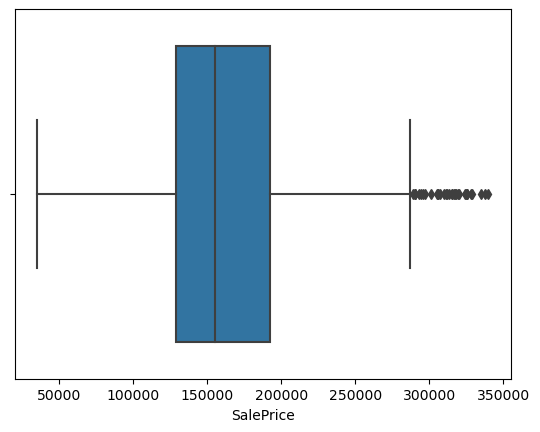

In [29]:
#re-checking for outliers in each columns
cont_cols_lst = cont_cols 
revised_cols = filter(lambda x: x not in out_zero_cols, cont_cols_lst)
cont_cols_lst = list(revised_cols)
for col in cont_cols_lst:
    sns.boxplot(x=df[col])
    plt.show()

### Performing EDA

### Univariat Analysis

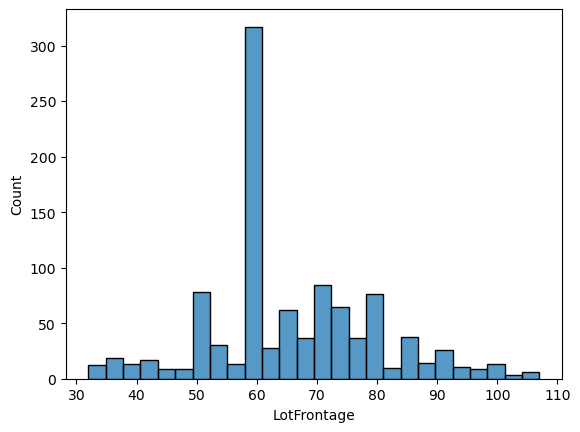

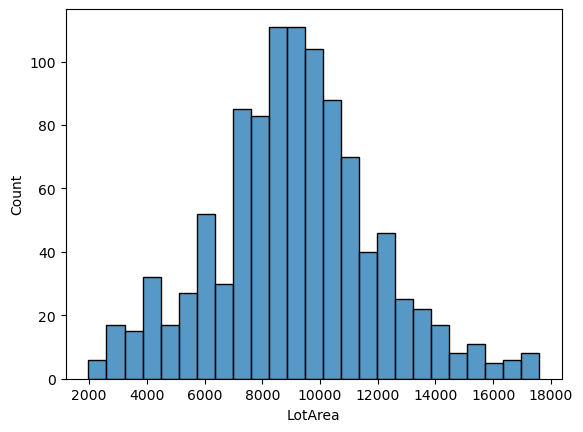

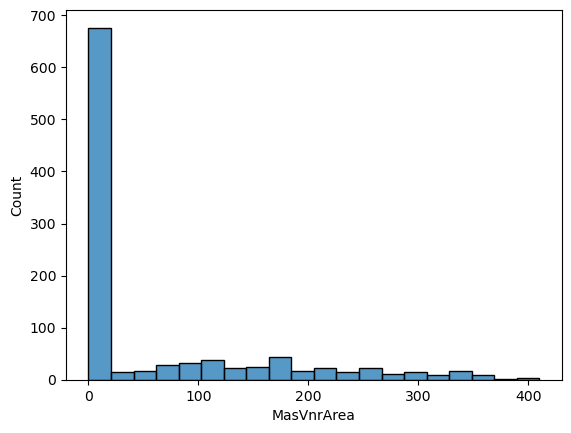

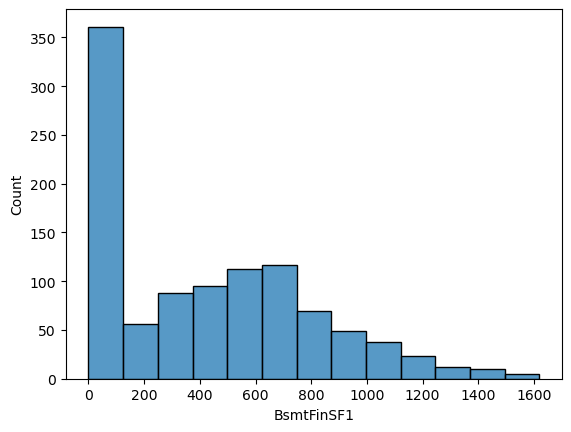

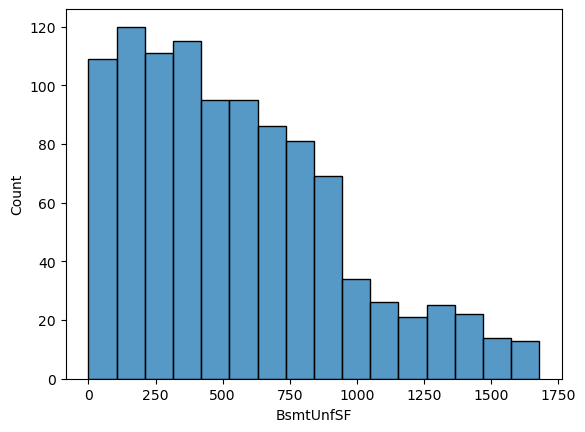

...

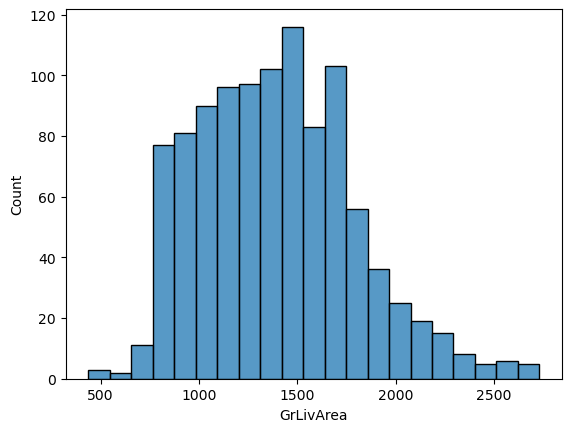

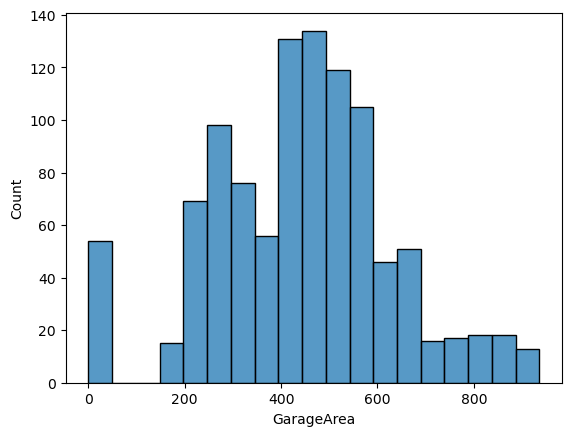

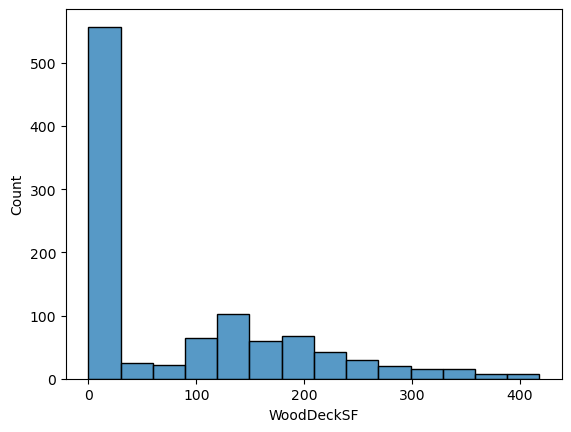

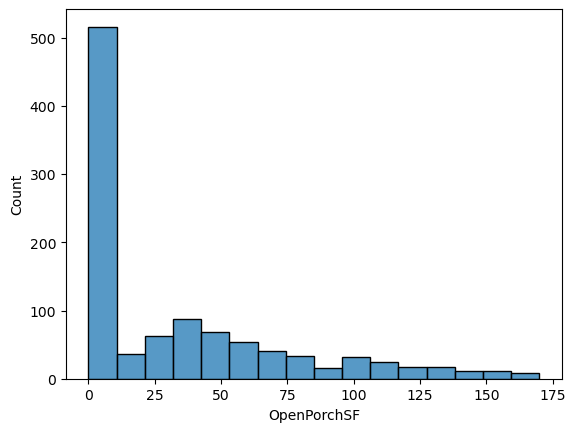

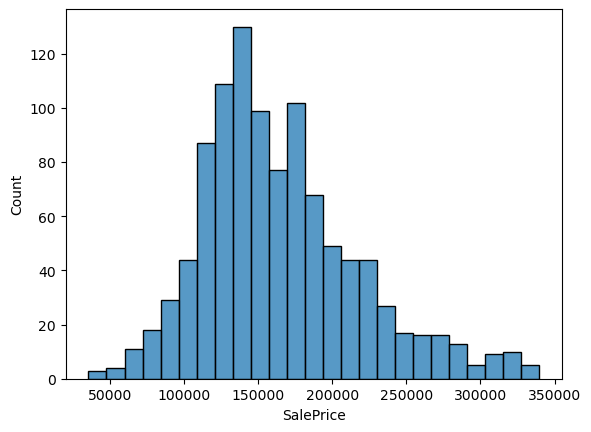

In [30]:
#ploting histogram against all quantitative columns for univariate analysis
for col in cont_cols_lst:
    sns.histplot(x=df[col])
    plt.show()

#### Performing univariate analysis on Categorical columns

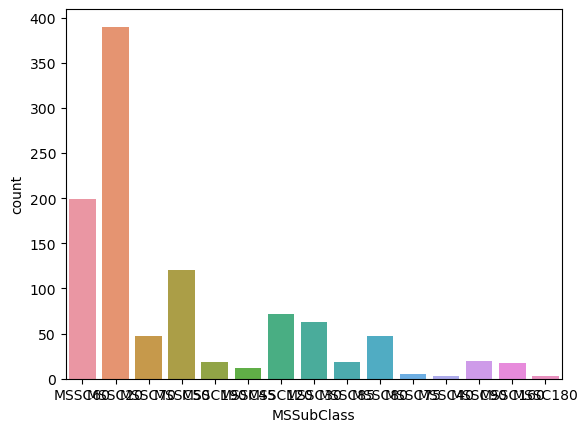

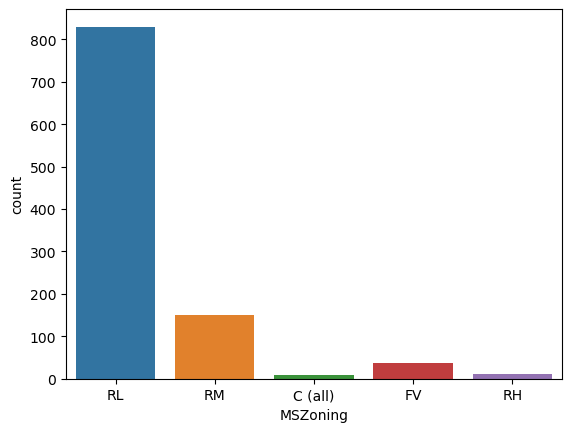

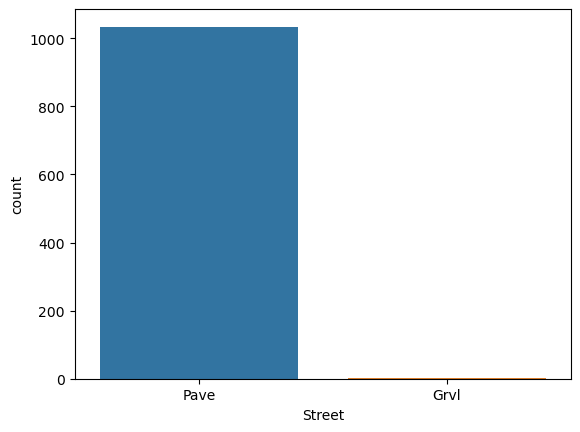

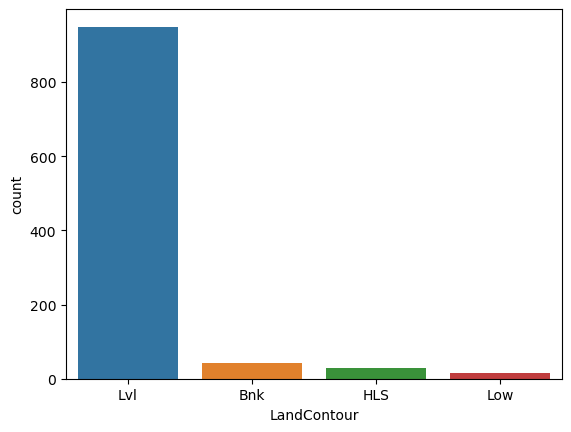

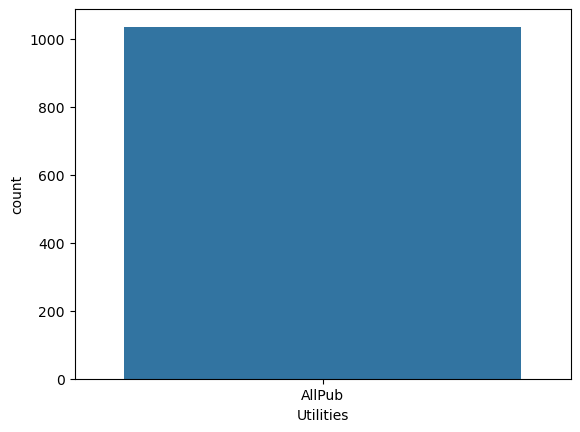

...

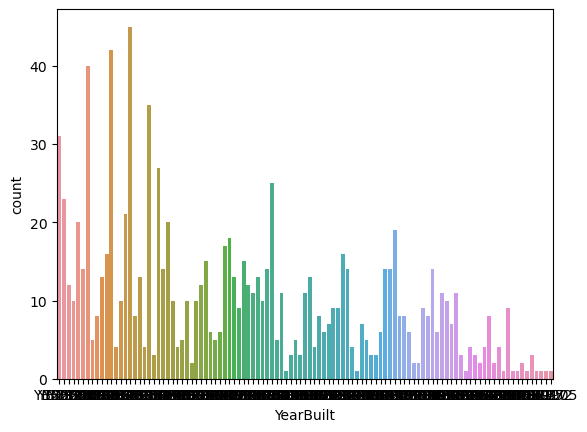

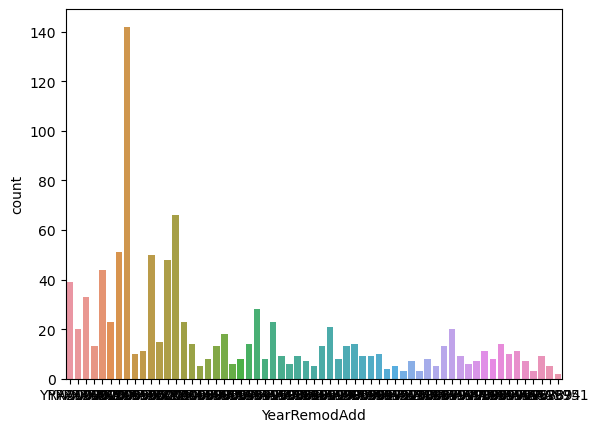

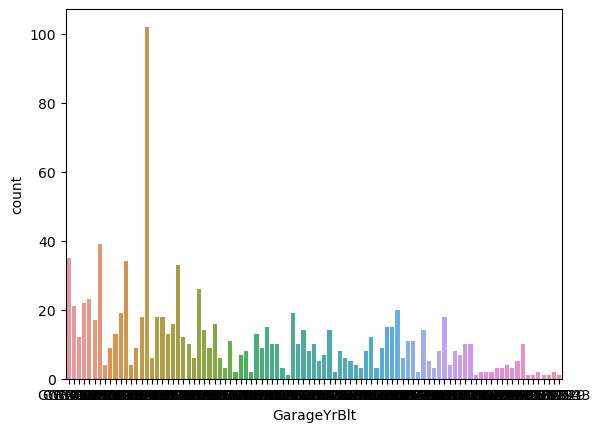

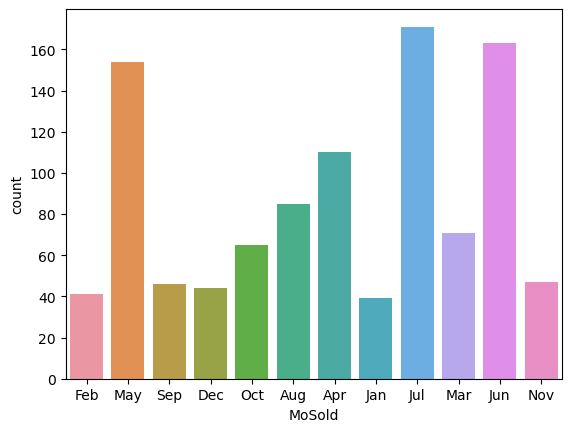

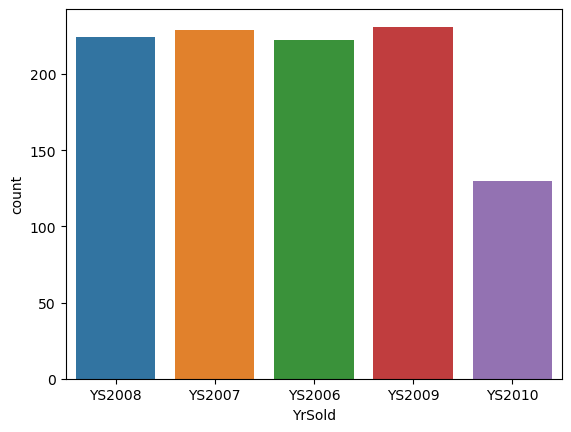

In [31]:
#ploting count plot against all categorical columns for univariate analysis
for cat in cat_cols_lst:
    sns.countplot(x=df[cat])
    plt.show()

### Bivariate Analysis

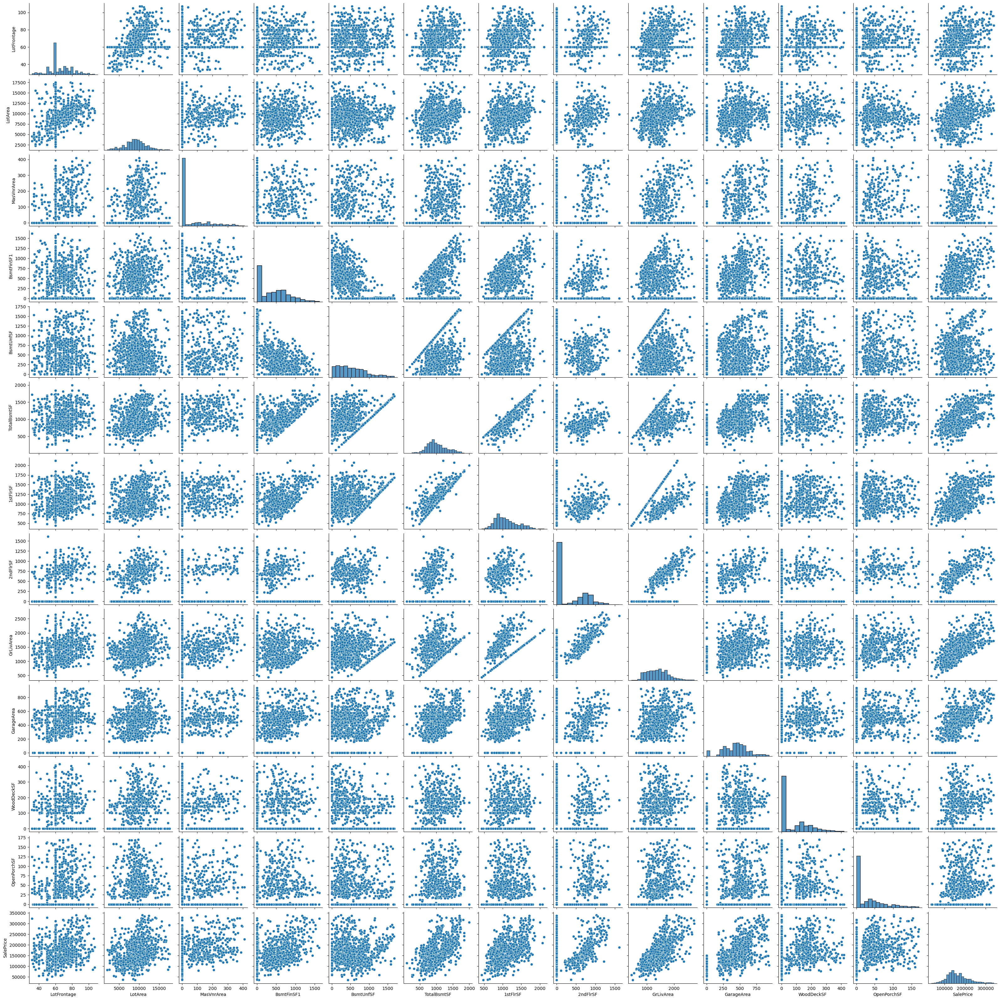

In [32]:
#ploting pair plot against all quantative columns for bivariate analysis
sns.pairplot(df[cont_cols_lst])
plt.show()

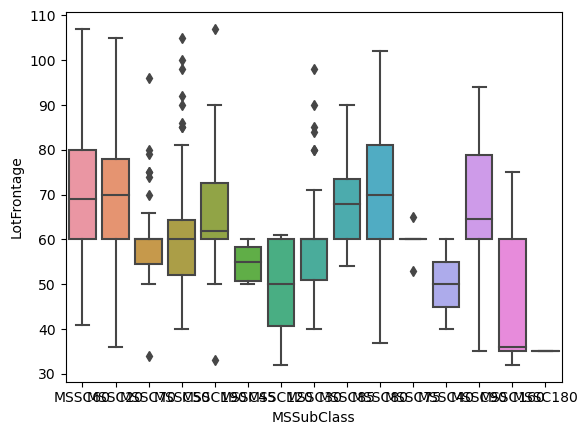

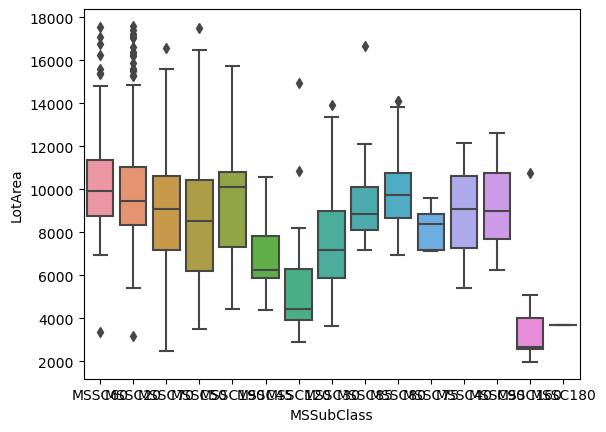

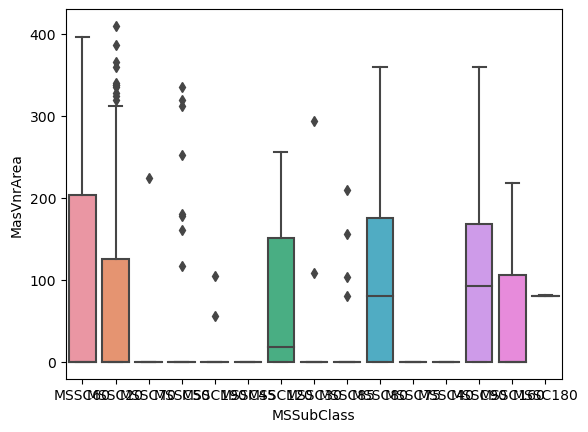

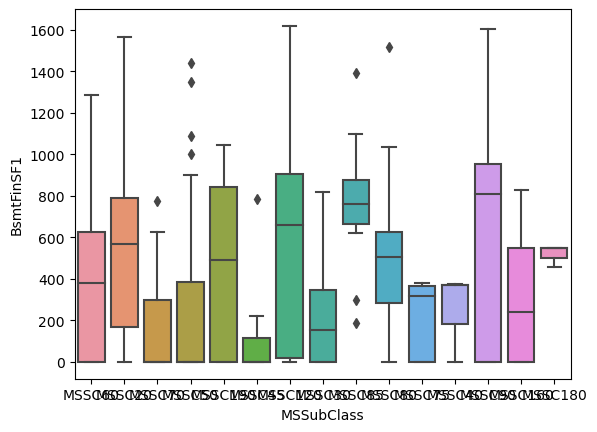

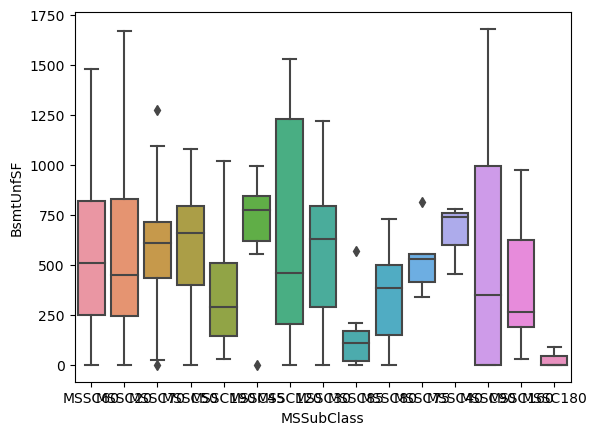

...

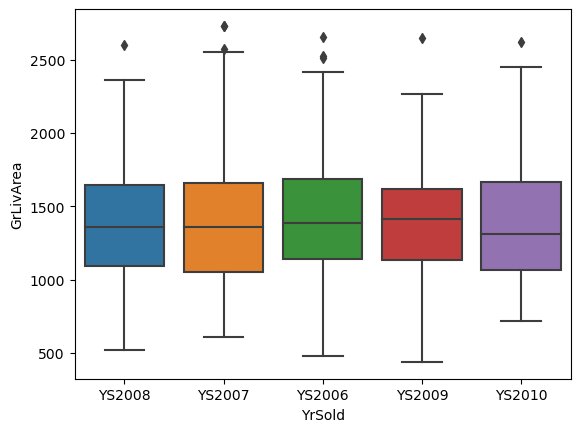

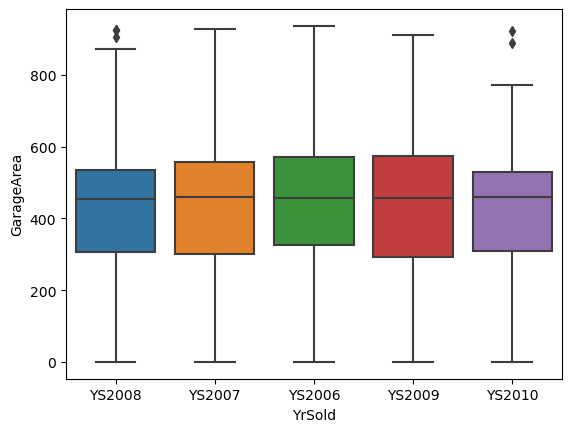

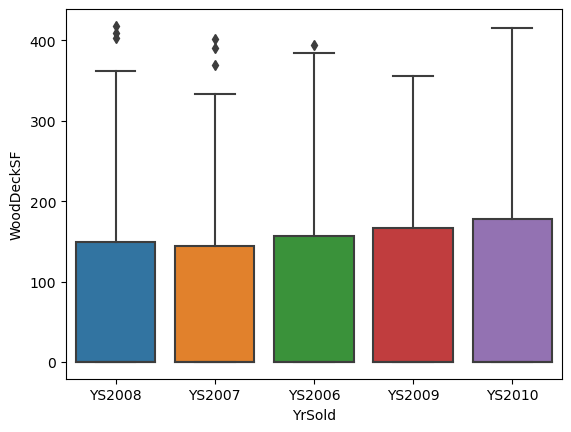

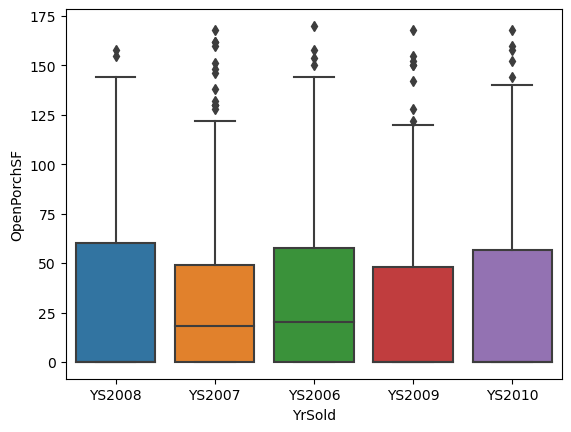

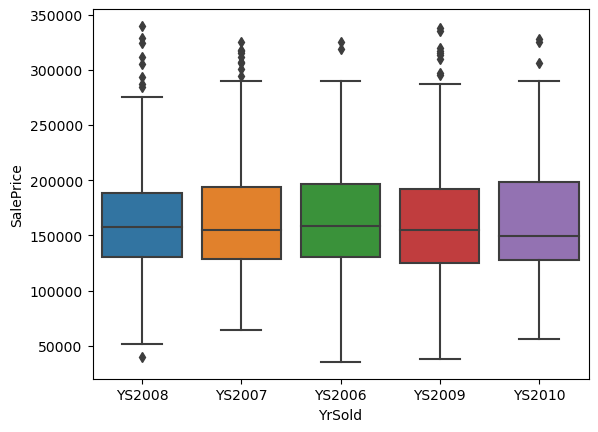

In [33]:
#ploting box plot showing result for each categorical column against each quantative column 
#for bivariate analysis
for col1 in cat_cols_lst:
    for col2 in cont_cols_lst:
        sns.boxplot(x=df[col1], y=df[col2])
        plt.show()

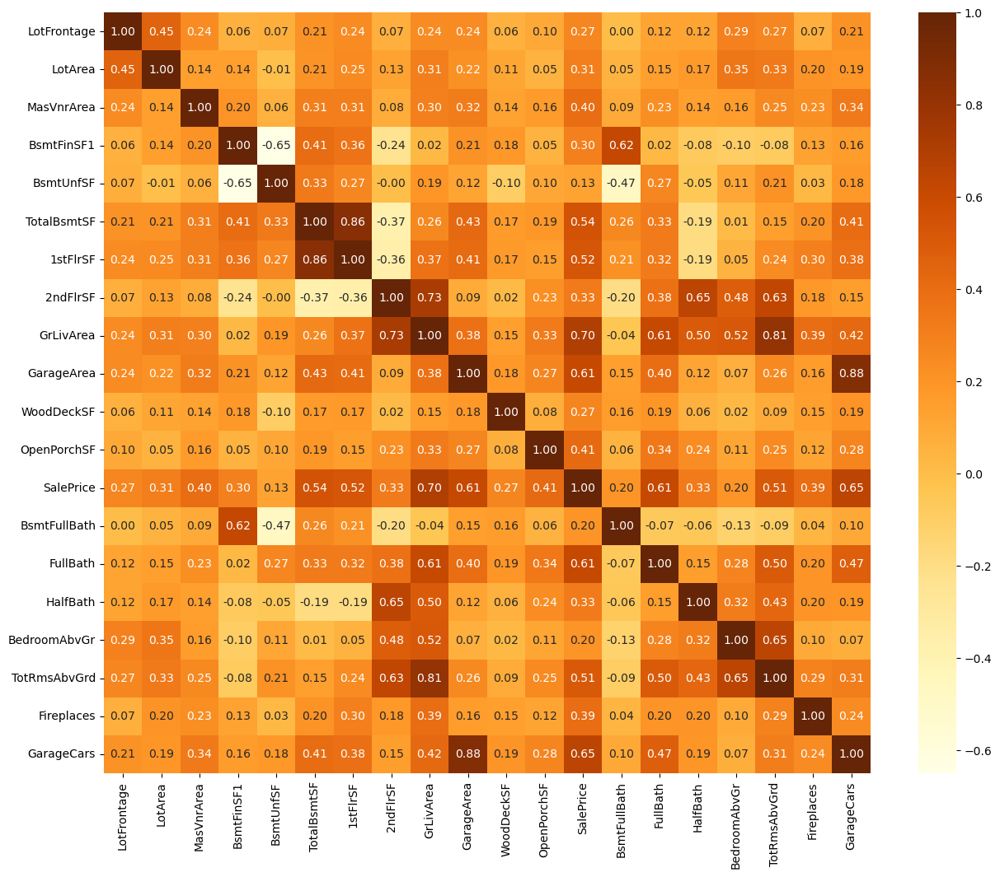

In [34]:
#ploting heat map showing corelation between different columns for bivariate analysis
hm_df = df[cont_cols_lst + cat_cols_lst]
plt.figure(figsize=(15,12))
sns.heatmap(hm_df.corr(), annot=True, fmt='.2f', cmap="YlOrBr")
plt.show()

### Creating Dummy columns

In [35]:
#dummy columns creations
dum_df = pd.get_dummies(df, columns=cat_cols_lst, drop_first=True)
dum_df.head()

,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,GarageArea,...,MoSold_Jun,MoSold_Mar,MoSold_May,MoSold_Nov,MoSold_Oct,MoSold_Sep,YrSold_YS2007,YrSold_YS2008,YrSold_YS2009,YrSold_YS2010
0,65.0,8450,196.0,706,150,856,856,854,1710,548,...,0,0,0,0,0,0,0,1,0,0
1,80.0,9600,0.0,978,284,1262,1262,0,1262,460,...,0,0,1,0,0,0,1,0,0,0
2,68.0,11250,162.0,486,434,920,920,866,1786,608,...,0,0,0,0,0,1,0,1,0,0
3,60.0,9550,0.0,216,540,756,961,756,1717,642,...,0,0,0,0,0,0,0,0,0,0
4,84.0,14260,350.0,655,490,1145,1145,1053,2198,836,...,0,0,0,0,0,0,0,1,0,0


### Rescaling the Features

In [36]:
#importing library for minmax scaling
from sklearn.preprocessing import MinMaxScaler

In [37]:
#performing min max scaling
scaler = MinMaxScaler()
dum_df[cont_cols_lst] = scaler.fit_transform(dum_df[cont_cols_lst])
dum_df.head()

,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,GarageArea,...,MoSold_Jun,MoSold_Mar,MoSold_May,MoSold_Nov,MoSold_Oct,MoSold_Sep,YrSold_YS2007,YrSold_YS2008,YrSold_YS2009,YrSold_YS2010
0,0.440000,0.414437,0.478049,0.436072,0.089286,0.396306,0.248958,0.530106,0.554974,0.585470,...,0,0,0,0,0,0,0,1,0,0
1,0.640000,0.488033,0.000000,0.604077,0.169048,0.610554,0.490768,0.000000,0.359511,0.491453,...,0,0,1,0,0,0,1,0,0,0
2,0.480000,0.593626,0.395122,0.300185,0.258333,0.430079,0.287076,0.537554,0.588133,0.649573,...,0,0,0,0,0,1,0,1,0,0
3,0.373333,0.484833,0.000000,0.133416,0.321429,0.343536,0.311495,0.469274,0.558028,0.685897,...,0,0,0,0,0,0,0,0,0,0
4,0.693333,0.786254,0.853659,0.404571,0.291667,0.548813,0.421084,0.653631,0.767888,0.893162,...,0,0,0,0,0,0,0,1,0,0


### Splitting the Data into Training and Testing Sets

In [38]:
#import spliting library
from sklearn.model_selection import train_test_split

In [39]:
#Spliting data set
df_train, df_test = train_test_split(dum_df, train_size=0.7, test_size=0.3, random_state=100)
df_train.head()

,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,GarageArea,...,MoSold_Jun,MoSold_Mar,MoSold_May,MoSold_Nov,MoSold_Oct,MoSold_Sep,YrSold_YS2007,YrSold_YS2008,YrSold_YS2009,YrSold_YS2010
711,0.453333,0.431204,0.000000,0.000000,0.511310,0.397889,0.250744,0.198014,0.322862,0.410256,...,0,0,0,0,0,0,0,0,0,1
1323,0.240000,0.214770,0.000000,0.172946,0.083333,0.166227,0.160810,0.000000,0.117801,0.000000,...,0,0,0,0,0,0,0,0,1,0
1384,0.373333,0.453475,0.000000,0.126004,0.211905,0.240106,0.154854,0.347610,0.357766,0.299145,...,0,0,0,0,1,0,0,0,1,0
289,0.373333,0.432356,0.000000,0.000000,0.415476,0.312929,0.154854,0.433271,0.417976,0.410256,...,0,0,0,0,0,0,1,0,0,0
1231,0.506667,0.368232,0.292683,0.495985,0.180357,0.528232,0.447886,0.000000,0.328098,0.576923,...,0,0,1,0,0,0,0,0,0,0


### Dividing into X and Y sets for the model building

In [40]:
y_train = df_train.pop('SalePrice')
x_train = df_train
y_test = df_test.pop('SalePrice')
x_test = df_test

## Model Building and Evaluation

In [41]:
#importing libraries for linear regreation
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import r2_score, mean_squared_error

### Using Linear Regression

In [42]:
# Instantiate
lm = LinearRegression()

# Fit a line
lm.fit(x_train, y_train)

LinearRegression()

In [43]:
# Print the coefficients and intercept
print(lm.intercept_)
print(lm.coef_)

-318463107829.81244
[ 1.51073951e-02  8.57168290e-02  1.35284004e-02 -1.12647685e-01
 -1.80699929e-01  3.03964337e-01  5.07509538e-01  5.21923121e-01
 -2.58361194e-01  8.34042376e-02 -3.42242364e-03  8.70643425e-03
 -1.09042238e-01 -5.97413147e-02  2.59388948e-01  3.70579361e-02
 -6.80328770e-03  1.51423530e-01  2.65860396e-01 -3.79521165e-02
 -1.82419511e-03 -1.28754757e-01 -9.40320789e+09 -4.94587593e-02
 -4.62800756e-03 -5.77759736e+11  2.02359552e-01  1.32717848e-01
  2.07404974e-01  2.10107987e-01  1.14412655e-02 -5.08032898e-02
 -3.86628848e-02 -2.18697224e-02  4.98395082e-03 -7.14410832e-03
  2.05598551e-02  5.19819717e-03 -1.99481317e-02 -3.37058117e+11
 -6.28113837e-03  6.77152423e-02 -1.93933138e-02  1.05092609e-01
 -3.21940149e-02 -6.22945688e-03  5.58955346e-03 -7.15330573e-02
  3.46475835e-03  1.78344046e-03 -6.87070832e-02 -2.52145166e-02
 -6.28504576e-02 -7.10465541e-03 -3.27563854e-02 -2.12794475e-03
 -2.81384217e-03 -2.51060606e-02  2.84614074e-02  1.48175301e-02
 -4.1

In [44]:
#Predicting and evaluating
y_pred_train = lm.predict(x_train)
y_pred_test = lm.predict(x_test)

metric = []
r2_train_lr = r2_score(y_train, y_pred_train)
print(r2_train_lr)
metric.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print(r2_test_lr)
metric.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print(rss1_lr)
metric.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print(rss2_lr)
metric.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train)
print(mse_train_lr)
metric.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test)
print(mse_test_lr)
metric.append(mse_test_lr**0.5)

0.943526488024958
-1.950394800396029e+23
1.275517433795759
1.8365949376986735e+24
0.0017593343914424264
5.905449960445896e+21


### Using Ridge Regression

In [45]:
# list of alphas to tune - if value too high it will lead to underfitting, if it is too low, 
# it will not handle the overfitting
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}

ridge = Ridge()

# cross validation
folds = 5
model_cv = GridSearchCV(estimator = ridge, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error',  
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
model_cv.fit(x_train, y_train)

Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [46]:
# Printing the best hyperparameter alpha
print(model_cv.best_params_)

{'alpha': 4.0}


In [47]:
#Fitting Ridge model for alpha = 4 and printing coefficients which have been penalised
alpha = 4
ridge = Ridge(alpha=alpha)
ridge.fit(x_train, y_train)
print(ridge.coef_)

[ 2.14749401e-02  4.80997785e-02  6.77748699e-03  5.05573245e-02
  4.29396846e-03  8.07552717e-02  9.80691593e-02  5.99126548e-02
  1.10694322e-01  5.00839877e-02  2.17256225e-02  1.76721210e-02
 -3.07047957e-02  7.72005317e-03 -1.06016759e-02  1.78400045e-02
 -5.89830844e-03  9.79217067e-04  3.94186401e-03  6.45410644e-04
  2.26329827e-02  1.65571959e-02  3.84413012e-03 -2.17192897e-04
 -7.10273453e-03 -1.45732134e-02  2.57400575e-02  4.99280669e-03
  2.15826594e-02  1.56960094e-02  8.49979793e-03 -6.87643766e-03
 -2.88356138e-03  1.77077519e-03  1.09550260e-02 -1.55900244e-02
 -3.05220654e-03 -3.30237226e-03  7.52643044e-03  0.00000000e+00
  5.94236794e-03  1.73777291e-02 -5.49326257e-03  5.73341657e-02
 -2.16056396e-02 -1.31289945e-02 -1.74015793e-02 -2.34918877e-02
 -1.14940383e-02 -1.44876260e-02  1.77715930e-03 -8.45665533e-03
 -3.75384195e-03  3.73819883e-02 -2.79065011e-02 -9.27939545e-03
 -1.83884946e-02  1.00202531e-02  3.35341390e-02  1.98234822e-02
 -3.19306088e-03  2.04922

In [48]:
# Lets calculate some metrics such as R2 score, RSS and RMSE
y_pred_train = ridge.predict(x_train)
y_pred_test = ridge.predict(x_test)

metric2 = []
r2_train_lr = r2_score(y_train, y_pred_train)
print(r2_train_lr)
metric2.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print(r2_test_lr)
metric2.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print(rss1_lr)
metric2.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print(rss2_lr)
metric2.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train)
print(mse_train_lr)
metric2.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test)
print(mse_test_lr)
metric2.append(mse_test_lr**0.5)

0.958528713912442
0.8730127840858819
0.9366753820798204
1.1957788128483595
0.001291966044248028
0.0038449479512808987


### Using Lasso Regression

In [49]:
#Initializing
lasso = Lasso()

# cross validation
model_cv = GridSearchCV(estimator = lasso, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            

model_cv.fit(x_train, y_train) 

Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [50]:
# Printing the best hyperparameter alpha
print(model_cv.best_params_)

{'alpha': 0.0001}


In [51]:
#Fitting Ridge model for alpha = .0001 and printing coefficients which have been penalised
alpha = .0001
lasso = Lasso(alpha=alpha)
lasso.fit(x_train, y_train)
print(lasso.coef_)

[ 8.04032760e-03  4.78044796e-02  5.07171094e-03  9.78920504e-03
 -4.56975904e-02  1.59761843e-01  2.51738537e-02  1.79292809e-02
  3.21327315e-01  5.27885027e-02  2.37740063e-02  9.78737601e-03
 -2.86126251e-02  0.00000000e+00 -1.33770112e-02  1.99499023e-02
  0.00000000e+00 -0.00000000e+00  0.00000000e+00 -8.54363165e-03
  3.09525772e-02  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -0.00000000e+00 -1.87991108e-02  3.43586662e-03  0.00000000e+00
  1.57936053e-02  1.41299877e-02  0.00000000e+00 -6.49257377e-03
 -0.00000000e+00  0.00000000e+00  8.88060697e-03 -1.39506627e-02
 -0.00000000e+00 -1.03972933e-03  6.29032343e-04  0.00000000e+00
  1.36613658e-02  6.78043995e-03  4.03055920e-04  7.21104991e-02
 -1.43653589e-02 -0.00000000e+00 -1.30053768e-02 -3.18332375e-02
 -6.33605341e-03 -7.40627424e-03  0.00000000e+00 -6.74951789e-03
  0.00000000e+00  3.50895240e-02 -2.91467668e-02 -0.00000000e+00
 -9.32883069e-03  1.41960567e-02  5.27875357e-02  1.05918667e-02
  0.00000000e+00  2.16138

In [52]:
# Lets calculate some metrics such as R2 score, RSS and RMSE

y_pred_train = lasso.predict(x_train)
y_pred_test = lasso.predict(x_test)

metric3 = []
r2_train_lr = r2_score(y_train, y_pred_train)
print(r2_train_lr)
metric3.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print(r2_test_lr)
metric3.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print(rss1_lr)
metric3.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print(rss2_lr)
metric3.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train)
print(mse_train_lr)
metric3.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test)
print(mse_test_lr)
metric3.append(mse_test_lr**0.5)

0.9595819424201874
0.8803220413361817
0.9128870381922719
1.1269509793168502
0.0012591545354376165
0.003623636589443248


In [53]:
# Creating a table which contain all the metrics
lr_table = {'Metric': ['R2 Score (Train)','R2 Score (Test)','RSS (Train)','RSS (Test)',
                       'MSE (Train)','MSE (Test)'], 
        'Linear Regression': metric
        }

lr_metric = pd.DataFrame(lr_table ,columns = ['Metric', 'Linear Regression'] )

rg_metric = pd.Series(metric2, name = 'Ridge Regression')
ls_metric = pd.Series(metric3, name = 'Lasso Regression')

final_metric = pd.concat([lr_metric, rg_metric, ls_metric], axis = 1)

final_metric

,Metric,Linear Regression,Ridge Regression,Lasso Regression
0,R2 Score (Train),9.435265e-01,0.958529,0.959582
1,R2 Score (Test),-1.950395e+23,0.873013,0.880322
2,RSS (Train),1.275517e+00,0.936675,0.912887
3,RSS (Test),1.836595e+24,1.195779,1.126951
4,MSE (Train),4.194442e-02,0.035944,0.035485
5,MSE (Test),7.684693e+10,0.062008,0.060197


## Lets observe the changes in the coefficients after regularization

In [54]:
betas = pd.DataFrame(index=x_train.columns)
betas.rows = x_train.columns
betas['Linear'] = lm.coef_
betas['Ridge'] = ridge.coef_
betas['Lasso'] = lasso.coef_
pd.set_option('display.max_rows', None)
betas.head(513)

,Linear,Ridge,Lasso
LotFrontage,1.510740e-02,0.021475,0.008040
LotArea,8.571683e-02,0.048100,0.047804
MasVnrArea,1.352840e-02,0.006777,0.005072
BsmtFinSF1,-1.126477e-01,0.050557,0.009789
BsmtUnfSF,-1.806999e-01,0.004294,-0.045698
TotalBsmtSF,3.039643e-01,0.080755,0.159762
1stFlrSF,5.075095e-01,0.098069,0.025174
2ndFlrSF,5.219231e-01,0.059913,0.017929
GrLivArea,-2.583612e-01,0.110694,0.321327
GarageArea,8.340424e-02,0.050084,0.052789
